In [52]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import plotly.express as px
import seaborn as sns
from sklearn.preprocessing import MinMaxScaler
from scipy import stats
from sklearn.cluster import KMeans
from sklearn.model_selection import train_test_split
import missingno as msno
import matplotlib_inline
from sklearn.metrics import silhouette_score

In [2]:
dt = pd.read_excel('Online Retail Data Set.xlsx')

In [3]:
dt.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 541909 entries, 0 to 541908
Data columns (total 8 columns):
 #   Column       Non-Null Count   Dtype         
---  ------       --------------   -----         
 0   InvoiceNo    541909 non-null  object        
 1   StockCode    541909 non-null  object        
 2   Description  540455 non-null  object        
 3   Quantity     541909 non-null  int64         
 4   InvoiceDate  541909 non-null  datetime64[ns]
 5   UnitPrice    541909 non-null  float64       
 6   CustomerID   406829 non-null  float64       
 7   Country      541909 non-null  object        
dtypes: datetime64[ns](1), float64(2), int64(1), object(4)
memory usage: 33.1+ MB


In [4]:
#Pre-processing and Feature Engineering:

In [5]:
dt.shape

(541909, 8)

In [6]:
dt.duplicated().sum()

5268

In [7]:
dt = dt.drop_duplicates()

In [8]:
dt.isna().sum()

InvoiceNo           0
StockCode           0
Description      1454
Quantity            0
InvoiceDate         0
UnitPrice           0
CustomerID     135037
Country             0
dtype: int64

In [9]:
dt = dt.dropna()

In [10]:
dt.duplicated().sum()

0

In [11]:
dt.isnull().sum()

InvoiceNo      0
StockCode      0
Description    0
Quantity       0
InvoiceDate    0
UnitPrice      0
CustomerID     0
Country        0
dtype: int64

In [12]:
dt.info()

<class 'pandas.core.frame.DataFrame'>
Index: 401604 entries, 0 to 541908
Data columns (total 8 columns):
 #   Column       Non-Null Count   Dtype         
---  ------       --------------   -----         
 0   InvoiceNo    401604 non-null  object        
 1   StockCode    401604 non-null  object        
 2   Description  401604 non-null  object        
 3   Quantity     401604 non-null  int64         
 4   InvoiceDate  401604 non-null  datetime64[ns]
 5   UnitPrice    401604 non-null  float64       
 6   CustomerID   401604 non-null  float64       
 7   Country      401604 non-null  object        
dtypes: datetime64[ns](1), float64(2), int64(1), object(4)
memory usage: 27.6+ MB


In [13]:
dt.shape

(401604, 8)

In [14]:
#creating separate columns for time, month, day and year

dt['Time'] = dt['InvoiceDate'].dt.time
dt['Month'] = dt['InvoiceDate'].dt.month_name()
dt['Day'] = dt['InvoiceDate'].dt.day_name()
dt['Year']= dt['InvoiceDate'].dt.year

In [15]:
#creating a column for total

dt['Total'] = dt['Quantity']*dt['UnitPrice']

In [16]:
dt.head()

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country,Time,Month,Day,Year,Total
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2010-12-01 08:26:00,2.55,17850.0,United Kingdom,08:26:00,December,Wednesday,2010,15.30
1,536365,71053,WHITE METAL LANTERN,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom,08:26:00,December,Wednesday,2010,20.34
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2010-12-01 08:26:00,2.75,17850.0,United Kingdom,08:26:00,December,Wednesday,2010,22.00
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom,08:26:00,December,Wednesday,2010,20.34
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom,08:26:00,December,Wednesday,2010,20.34


In [17]:
dt.describe()

,Quantity,InvoiceDate,UnitPrice,CustomerID,Year,Total
count,401604.000000,401604,401604.000000,401604.000000,401604.000000,401604.000000
mean,12.183273,2011-07-10 12:08:23.848567552,3.474064,15281.160818,2010.934378,20.613638
min,-80995.000000,2010-12-01 08:26:00,0.000000,12346.000000,2010.000000,-168469.600000
25%,2.000000,2011-04-06 15:02:00,1.250000,13939.000000,2011.000000,4.250000
50%,5.000000,2011-07-29 15:40:00,1.950000,15145.000000,2011.000000,11.700000
75%,12.000000,2011-10-20 11:58:30,3.750000,16784.000000,2011.000000,19.800000
max,80995.000000,2011-12-09 12:50:00,38970.000000,18287.000000,2011.000000,168469.600000
std,250.283037,NaN,69.764035,1714.006089,0.247620,430.352218


<Axes: ylabel='UnitPrice'>

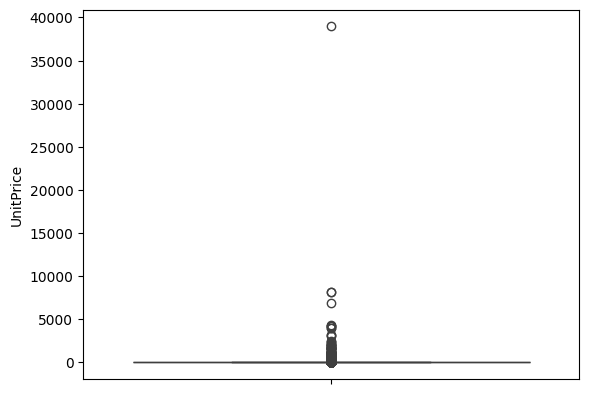

In [18]:
#Unit Price Distribution
sns.boxplot(y = 'UnitPrice', data=dt)

In [19]:
dt['UnitPrice'].min()

0.0

<Axes: ylabel='Quantity'>

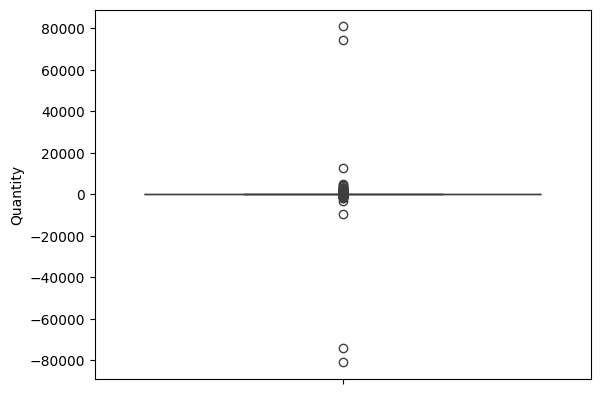

In [20]:
sns.boxplot(y = 'Quantity', data=dt)

In [21]:
dt[dt['Quantity']<0]

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country,Time,Month,Day,Year,Total
141,C536379,D,Discount,-1,2010-12-01 09:41:00,27.50,14527.0,United Kingdom,09:41:00,December,Wednesday,2010,-27.50
154,C536383,35004C,SET OF 3 COLOURED FLYING DUCKS,-1,2010-12-01 09:49:00,4.65,15311.0,United Kingdom,09:49:00,December,Wednesday,2010,-4.65
235,C536391,22556,PLASTERS IN TIN CIRCUS PARADE,-12,2010-12-01 10:24:00,1.65,17548.0,United Kingdom,10:24:00,December,Wednesday,2010,-19.80
236,C536391,21984,PACK OF 12 PINK PAISLEY TISSUES,-24,2010-12-01 10:24:00,0.29,17548.0,United Kingdom,10:24:00,December,Wednesday,2010,-6.96
237,C536391,21983,PACK OF 12 BLUE PAISLEY TISSUES,-24,2010-12-01 10:24:00,0.29,17548.0,United Kingdom,10:24:00,December,Wednesday,2010,-6.96
...,...,...,...,...,...,...,...,...,...,...,...,...,...
540449,C581490,23144,ZINC T-LIGHT HOLDER STARS SMALL,-11,2011-12-09 09:57:00,0.83,14397.0,United Kingdom,09:57:00,December,Friday,2011,-9.13
541541,C581499,M,Manual,-1,2011-12-09 10:28:00,224.69,15498.0,United Kingdom,10:28:00,December,Friday,2011,-224.69
541715,C581568,21258,VICTORIAN SEWING BOX LARGE,-5,2011-12-09 11:57:00,10.95,15311.0,United Kingdom,11:57:00,December,Friday,2011,-54.75
541716,C581569,84978,HANGING HEART JAR T-LIGHT HOLDER,-1,2011-12-09 11:58:00,1.25,17315.0,United Kingdom,11:58:00,December,Friday,2011,-1.25


In [22]:
#The negative quantity might be cancelled purchases 
cancelled_purchases = dt[dt['Quantity'] < 0]

In [23]:
#Let's include only the purchased products in our dataset
dt = dt[dt['Quantity']>0]

In [24]:
dt['Quantity'].min()

1

In [25]:
#Exploratory Data Analysis (EDA):

In [26]:
#Country-Wise Sales:
fig = px.histogram(dt, x="Total",y='Country')

fig.update_layout(
    template="plotly",  
    title="Country-Wise Sales ",
    xaxis_title="Total Sales", 
    yaxis_title="Country",  
)

fig.show()

In [27]:
fig = px.histogram(dt, x="Month",y='Total')

fig.update_layout(
    template="plotly",  
    title="Monthly Sales ",
    xaxis_title="Month", 
    yaxis_title="Total Sales",  
)

fig.show()

In [28]:
#Monthly Sales by Country
fig = px.histogram(dt, x="Month", y='Total', color='Country', color_discrete_sequence=px.colors.qualitative.Set1)

fig.update_layout(
    template="plotly",
    title="Monthly Sales by Country ",
    xaxis_title="Month", 
    yaxis_title="Total Sales",  
)

fig.show()

In [29]:
dt['Hour'] = dt['InvoiceDate'].dt.hour
dt['Minute'] = dt['InvoiceDate'].dt.minute

In [30]:
#Average Sales by Hour
hourly_sales = dt.groupby('Hour')['Total'].mean().reset_index()

fig = px.line(hourly_sales, x='Hour', y='Total', title='Average Sales by Hour')
fig.update_layout(template='plotly', xaxis_title='Hour', yaxis_title='Average Sales')
fig.show()

In [31]:
#Most Selling Products:
dt['Description'].value_counts().head(10)

Description
WHITE HANGING HEART T-LIGHT HOLDER    2016
REGENCY CAKESTAND 3 TIER              1714
JUMBO BAG RED RETROSPOT               1615
ASSORTED COLOUR BIRD ORNAMENT         1395
PARTY BUNTING                         1390
LUNCH BAG RED RETROSPOT               1303
SET OF 3 CAKE TINS PANTRY DESIGN      1152
POSTAGE                               1099
LUNCH BAG  BLACK SKULL.               1078
PACK OF 72 RETROSPOT CAKE CASES       1050
Name: count, dtype: int64

In [32]:
#RFM Analysis

In [39]:
#Sum of total transactions:

dt['CustomerID'] = dt['CustomerID'].astype(str)
rfm_m = dt.groupby('CustomerID')['Total'].sum()
rfm_m.reset_index()
rfm_m.columns = ['CustomerID', 'Total']
print(rfm_m)

CustomerID
12346.0    77183.60
12347.0     4310.00
12348.0     1797.24
12349.0     1757.55
12350.0      334.40
             ...   
18280.0      180.60
18281.0       80.82
18282.0      178.05
18283.0     2045.53
18287.0     1837.28
Name: Total, Length: 4339, dtype: float64


In [38]:
#No. of transactions

rfm_f = dt.groupby('CustomerID')['InvoiceNo'].count()
rfm_f = rfm_f.reset_index()
rfm_f.columns = ['CustomerID', 'Frequency']
print(rfm_f)

     CustomerID  Frequency
0       12346.0          1
1       12347.0        182
2       12348.0         31
3       12349.0         73
4       12350.0         17
...         ...        ...
4334    18280.0         10
4335    18281.0          7
4336    18282.0         12
4337    18283.0        721
4338    18287.0         70

[4339 rows x 2 columns]


In [41]:
#No. of days since last purchase

dt['InvoiceDate'] = pd.to_datetime(dt['InvoiceDate'],format='%d-%m-%Y %H:%M')
max_date = max(dt['InvoiceDate'])
dt['Difference'] = max_date - dt['InvoiceDate']
rfm_d = dt.groupby('CustomerID')['Difference'].min()
rfm_d = rfm_d.reset_index()
rfm_d.columns = ['CustomerID','Difference']
rfm_d['Difference'] = rfm_d['Difference'].dt.days
print(rfm_d)

     CustomerID  Difference
0       12346.0         325
1       12347.0           1
2       12348.0          74
3       12349.0          18
4       12350.0         309
...         ...         ...
4334    18280.0         277
4335    18281.0         180
4336    18282.0           7
4337    18283.0           3
4338    18287.0          42

[4339 rows x 2 columns]


In [43]:
rfm = pd.merge(rfm_m,rfm_f,on='CustomerID',how='inner')
rfm = pd.merge(rfm,rfm_d,on='CustomerID',how='inner')
rfm.columns = ['CustomerID', 'Monetary', 'Frequency', 'Recency']
print(rfm.head())

  CustomerID  Monetary  Frequency  Recency
0    12346.0  77183.60          1      325
1    12347.0   4310.00        182        1
2    12348.0   1797.24         31       74
3    12349.0   1757.55         73       18
4    12350.0    334.40         17      309


In [44]:
#Removing outliers using the Interquartile Range (IQR) method:

Q1 = rfm.Monetary.quantile(0.05)
Q3 = rfm.Monetary.quantile(0.95)
IQR = Q3 - Q1
rfm = rfm[(rfm.Monetary >= Q1 - 1.5*IQR) & (rfm.Monetary <= Q3 + 1.5*IQR)]

Q1 = rfm.Recency.quantile(0.05)
Q3 = rfm.Recency.quantile(0.95)
IQR = Q3 - Q1
rfm = rfm[(rfm.Recency >= Q1 - 1.5*IQR) & (rfm.Recency <= Q3 + 1.5*IQR)]

Q1 = rfm.Frequency.quantile(0.05)
Q3 = rfm.Frequency.quantile(0.95)
IQR = Q3 - Q1
rfm = rfm[(rfm.Frequency >= Q1 - 1.5*IQR) & (rfm.Frequency <= Q3 + 1.5*IQR)]

In [45]:
rfm.shape

(4258, 4)

In [46]:
#scaling

X = rfm[['Monetary', 'Frequency', 'Recency']]
scaler = MinMaxScaler()
rfm_s = scaler.fit_transform(X)

In [47]:
rfm_s = pd.DataFrame(rfm_s)
rfm_s.columns = ['Monetary', 'Frequency', 'Recency']
rfm_s.head()

,Monetary,Frequency,Recency
0,0.307090,0.251389,0.002681
1,0.128054,0.041667,0.198391
2,0.125226,0.100000,0.048257
3,0.023826,0.022222,0.828418
4,0.178557,0.116667,0.093834


In [ ]:
#Create our model

In [49]:
km = KMeans(n_clusters=3, max_iter=50)
km.fit(rfm_s)
lb = km.labels_
km.labels_

array([2, 1, 1, ..., 1, 2, 1])

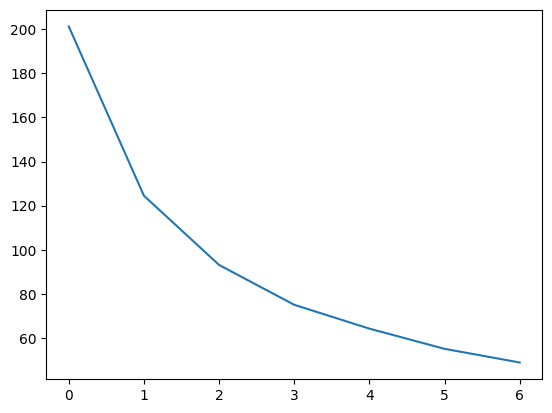

In [50]:
#Elbow method to find optimal number of clusters for K-means clustering:
#wss = Within-Cluster Sum of Squares
# The elbow point in the curve indicates the optimal number of clusters

wss = []
range_n_clusters = [2, 3, 4, 5, 6, 7, 8]
for num_clusters in range_n_clusters:
    km = KMeans(n_clusters=num_clusters, max_iter=50)
    km.fit(rfm_s)
    wss.append(km.inertia_)
    
plt.plot(wss)

In [53]:
#Silhouette Analysis
#The silhouette score measures how similar an object is to its own cluster (cohesion) 
#compared to other clusters (separation). It ranges from -1 to 1, where a higher value 
#indicates better clustering

range_n_clusters = [2, 3, 4, 5, 6, 7, 8]
for num_clusters in range_n_clusters:
    km = KMeans(n_clusters=num_clusters, max_iter=50)
    km.fit(rfm_s)
    cluster_labels = km.labels_
    silhouette_avg = silhouette_score(rfm_s, cluster_labels)
    print("For n_clusters={0}, the silhouette score is {1}".format(num_clusters, silhouette_avg))

For n_clusters=2, the silhouette score is 0.5732595370817085
For n_clusters=3, the silhouette score is 0.5535208906148475
For n_clusters=4, the silhouette score is 0.49252799716739876
For n_clusters=5, the silhouette score is 0.4404276650095057
For n_clusters=6, the silhouette score is 0.3916233674782735
For n_clusters=7, the silhouette score is 0.39380419624323604
For n_clusters=8, the silhouette score is 0.3763560503293119


In [54]:
rfm['Cluster_Id'] = lb
rfm.head()

,CustomerID,Monetary,Frequency,Recency,Cluster_Id
1,12347.0,4310.00,182,1,2
2,12348.0,1797.24,31,74,1
3,12349.0,1757.55,73,18,1
4,12350.0,334.40,17,309,0
5,12352.0,2506.04,85,35,1


<Axes: xlabel='Cluster_Id', ylabel='Monetary'>

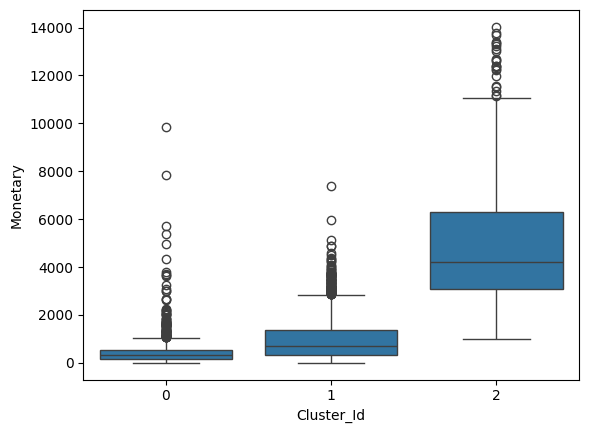

In [56]:
sns.boxplot(x='Cluster_Id', y='Monetary', data=rfm)

In [ ]:
#Here we see that the people in cluster 1 and 2 have spent more than cluster 0
#People in cluster 2 have spent the most

<Axes: xlabel='Cluster_Id', ylabel='Frequency'>

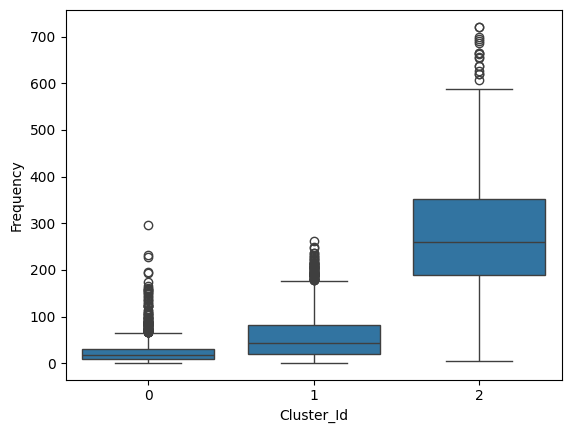

In [57]:
sns.boxplot(x='Cluster_Id', y='Frequency', data=rfm)

In [ ]:
#People in cluster 2 have made the highest no. of trasactions

<Axes: xlabel='Cluster_Id', ylabel='Recency'>

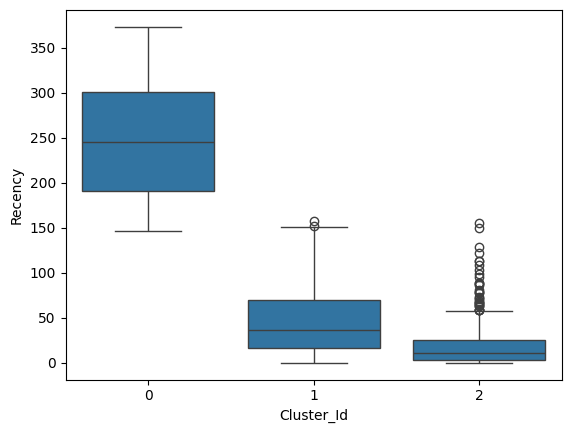

In [58]:
sns.boxplot(x='Cluster_Id', y='Recency', data=rfm)

In [ ]:
#Here, people in cluster 0 are the most frequest buyers